## Data Exploration

### Problem Statement

Tanzanian Ministry of Water wants invest X amount of money on improving the water supply in their country. In order to do that, they want to identify the wells that needs immediate attention. They want to find out the number of wells that are disfunctional and or needs repairs. Based on that, they want to focus on the area or location of wells they should give priorty, and also type of the well.
This project aims to solve that problem by predicting wells as accurate as possible.

### Evaluation criteria
Our model evaluation will be focused on getting the recall metrics as high as possible.

In [14]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
%matplotlib inline
sns.set_theme(style='darkgrid')

import sklearn
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import SMOTE, SMOTENC
# import xgboost as XGB
# from xgboost import XGBClassifier

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn import metrics
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import confusion_matrix, plot_confusion_matrix
from sklearn.metrics import f1_score, accuracy_score, classification_report
from sklearn.metrics import roc_curve, auc
from sklearn import set_config
set_config(display='diagram')

import warnings
warnings.filterwarnings(action='ignore')

In [2]:
submission = pd.read_csv('SubmissionFormat.csv')
test = pd.read_csv('Test_set_values.csv')
train  = pd.read_csv('Training_set_values.csv')
target = pd.read_csv('Training_set_labels.csv')

In [3]:
df = pd.merge(train, target, on = 'id')

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59400 entries, 0 to 59399
Data columns (total 41 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55765 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59400 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

In [5]:
df.describe()

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,59400.000000,59400.000000,59400.000000,59400.000000,5.940000e+04,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000
mean,37115.131768,317.650385,668.297239,34.077427,-5.706033e+00,0.474141,15.297003,5.629747,179.909983,1300.652475
std,21453.128371,2997.574558,693.116350,6.567432,2.946019e+00,12.236230,17.587406,9.633649,471.482176,951.620547
min,0.000000,0.000000,-90.000000,0.000000,-1.164944e+01,0.000000,1.000000,0.000000,0.000000,0.000000
25%,18519.750000,0.000000,0.000000,33.090347,-8.540621e+00,0.000000,5.000000,2.000000,0.000000,0.000000
50%,37061.500000,0.000000,369.000000,34.908743,-5.021597e+00,0.000000,12.000000,3.000000,25.000000,1986.000000
75%,55656.500000,20.000000,1319.250000,37.178387,-3.326156e+00,0.000000,17.000000,5.000000,215.000000,2004.000000
max,74247.000000,350000.000000,2770.000000,40.345193,-2.000000e-08,1776.000000,99.000000,80.000000,30500.000000,2013.000000


In [6]:
# Evaluate unique categories for categorical columns
uniq_categories = {}
for column in list(df.columns):
    if df[column].dtype == 'object':
        uniq_categories[column] = len(df[column].unique())       
    else:
        pass
dict(sorted(uniq_categories.items(), key = lambda x : x[1]))

{'recorded_by': 1,
 'public_meeting': 3,
 'permit': 3,
 'source_class': 3,
 'status_group': 3,
 'management_group': 5,
 'quantity': 5,
 'quantity_group': 5,
 'quality_group': 6,
 'waterpoint_type_group': 6,
 'extraction_type_class': 7,
 'payment': 7,
 'payment_type': 7,
 'source_type': 7,
 'waterpoint_type': 7,
 'water_quality': 8,
 'basin': 9,
 'source': 10,
 'management': 12,
 'scheme_management': 13,
 'extraction_type_group': 13,
 'extraction_type': 18,
 'region': 21,
 'lga': 125,
 'date_recorded': 356,
 'funder': 1898,
 'ward': 2092,
 'installer': 2146,
 'scheme_name': 2697,
 'subvillage': 19288,
 'wpt_name': 37400}

In [7]:
# Columns with large categoriies. We will need to find a way to one-hot-encode and avoid having too many features.
# For now we will drop these columns from our training set. We will also remove 'id' column.
# cols_large_categ =  ['id', 'lga', 'date_recorded', 'funder', 'ward', 'installer', 'scheme_name', 'subvillage', 'wpt_name'] 
# df.drop(columns = cols_large_categ, axis=1, inplace=True)
# df.head()

,amount_tsh,gps_height,longitude,latitude,num_private,basin,region,region_code,district_code,population,...,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group
0,6000.0,1390,34.938093,-9.856322,0,Lake Nyasa,Iringa,11,5,109,...,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
1,0.0,1399,34.698766,-2.147466,0,Lake Victoria,Mara,20,2,280,...,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
2,25.0,686,37.460664,-3.821329,0,Pangani,Manyara,21,4,250,...,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,functional
3,0.0,263,38.486161,-11.155298,0,Ruvuma / Southern Coast,Mtwara,90,63,58,...,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,non functional
4,0.0,0,31.130847,-1.825359,0,Lake Victoria,Kagera,18,1,0,...,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional


In [8]:
# Next we will evaluate missing data
df.isna().sum().sort_values()

amount_tsh                  0
waterpoint_type             0
source_class                0
source_type                 0
source                      0
quantity_group              0
quantity                    0
quality_group               0
water_quality               0
payment_type                0
payment                     0
management_group            0
management                  0
extraction_type_class       0
extraction_type_group       0
extraction_type             0
construction_year           0
recorded_by                 0
population                  0
district_code               0
region_code                 0
region                      0
basin                       0
num_private                 0
latitude                    0
longitude                   0
gps_height                  0
waterpoint_type_group       0
status_group                0
permit                   3056
public_meeting           3334
scheme_management        3877
dtype: int64

In [9]:
# columns with missing values:
cols_na = ['permit', 'public_meeting', 'scheme_management']

# 'permit' is a True/False and has nan
# Filling strategy = 'most_frequent'

# 'public_meeting' is also a True/False and has nan
# Filling strategy = 'most_frequent'

# 'scheme_management' has 13 categories including nan and also a 'None' category
# Filling strategy = 'convert nan to None'  # But this column will be dropped!

In [10]:
# Next we will evaluate numerical features by itself to check any outliers or something
numeric_cols = [col for col in df.columns if
                  df[col].dtype in ['int64', 'float64']]
numeric_cols

['amount_tsh',
 'gps_height',
 'longitude',
 'latitude',
 'num_private',
 'region_code',
 'district_code',
 'population',
 'construction_year']

<AxesSubplot:>

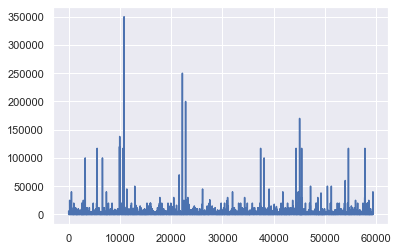

In [11]:
df.amount_tsh.loc[lambda x: x > 0].plot()

The larger value of total static head are correlated to functional water pump.
Therefore, 'amount_tsf' seems to be important indicator of water pump failure.

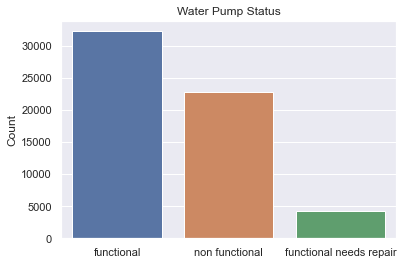

In [12]:
sns.countplot(data=df, x= 'status_group')
plt.title('Water Pump Status')
plt.xlabel('')
plt.ylabel('Count')
plt.savefig('images/water_pump_status_count.png')

In [14]:
df.loc[df.construction_year >0].construction_year.describe()

count    38691.000000
mean      1996.814686
std         12.472045
min       1960.000000
25%       1987.000000
50%       2000.000000
75%       2008.000000
max       2013.000000
Name: construction_year, dtype: float64

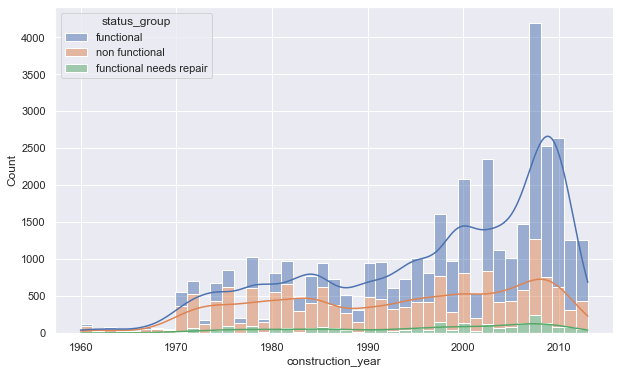

In [15]:
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.histplot(data = df.loc[df['construction_year']>0],
             x = 'construction_year',
             hue = 'status_group', multiple = 'stack', kde = True)
plt.savefig('images/water_pump_status_by_construction_year.png', bbox_inces='tight')

It is ovbious that the older waterpumps are disfunctional. Interestingly, the functional pumps is on the decline in the last decade.

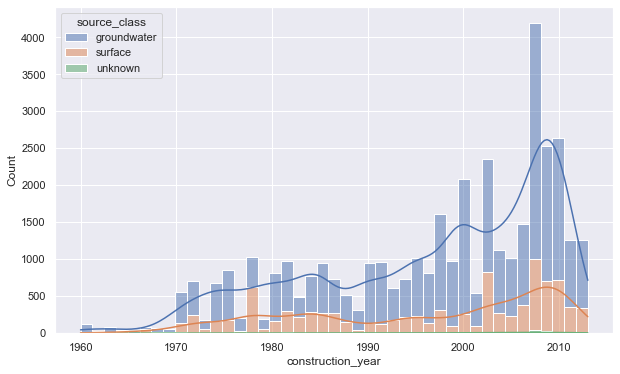

In [20]:
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.histplot(data = df.loc[df['construction_year']>0],
             x = 'construction_year', 
             hue = 'source_class', multiple = 'stack', kde = True)

In [21]:
df.district_code.unique()

array([ 5,  2,  4, 63,  1,  8,  3,  6, 43,  7, 23, 33, 53, 62, 60, 30, 13,
        0, 80, 67], dtype=int64)

It is hard explain if num_private is a useful features. We will drop it from our test

<AxesSubplot:xlabel='region_code', ylabel='status_group'>

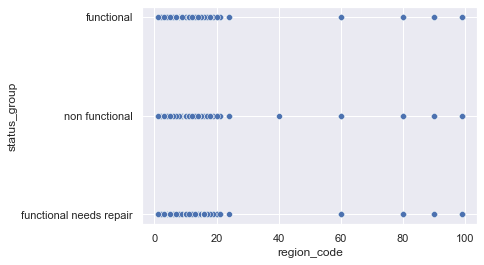

In [22]:
sns.scatterplot(data=df, x= 'region_code', y= 'status_group')

region_code is also not correlable

<AxesSubplot:xlabel='gps_height', ylabel='amount_tsh'>

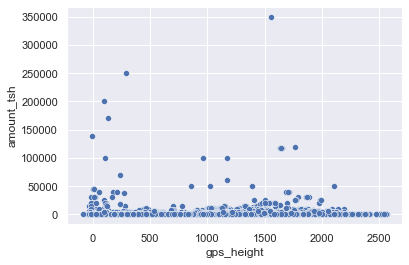

In [23]:
sns.scatterplot(data = df.loc[df['amount_tsh'] > 0], x = 'gps_height', y='amount_tsh')

In [24]:
df['compare'] = np.where((df.quantity == df.quantity_group), 'True', 'False')
df['compare'].value_counts()

True    59400
Name: compare, dtype: int64

'quantity' and 'quantity_group' are basically the same. We will drop 'quantity'.

In [25]:
df.scheme_management.value_counts()

VWC                 36793
WUG                  5206
Water authority      3153
WUA                  2883
Water Board          2748
Parastatal           1680
Private operator     1063
Company              1061
Other                 766
SWC                    97
Trust                  72
None                    1
Name: scheme_management, dtype: int64

In [26]:
df.management.value_counts()

vwc                 40507
wug                  6515
water board          2933
wua                  2535
private operator     1971
parastatal           1768
water authority       904
other                 844
company               685
unknown               561
other - school         99
trust                  78
Name: management, dtype: int64

In [27]:
df.management_group.value_counts()

user-group    52490
commercial     3638
parastatal     1768
other           943
unknown         561
Name: management_group, dtype: int64

In [28]:
df['management_group_edit'] = df['management_group']

df['management_group_edit'] = np.where(df['management_group_edit']=='unknown', df['scheme_management'], 
                                      df['management_group_edit'])
df['management_group_edit'].value_counts()

user-group    52490
commercial     3638
parastatal     1768
other           943
VWC              76
Other             8
Parastatal        4
WUG               4
WUA               1
Name: management_group_edit, dtype: int64

Between 'scheme_management', 'management' and 'management_group', the latter seems to be high level. We will try dropping out one versus other to see the effect. Some of the unknowns may be filled from other columns.

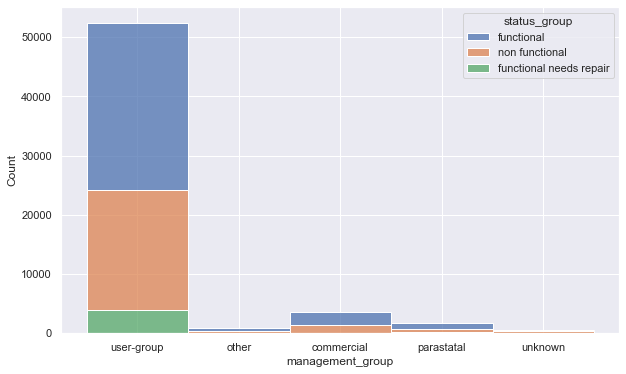

In [29]:
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.histplot(data = df, x = 'management_group', 
             hue = 'status_group', multiple = 'stack', kde = False)

In [30]:
df.quality_group.value_counts()

good        50818
salty        5195
unknown      1876
milky         804
colored       490
fluoride      217
Name: quality_group, dtype: int64

In [31]:
df.water_quality.value_counts()

soft                  50818
salty                  4856
unknown                1876
milky                   804
coloured                490
salty abandoned         339
fluoride                200
fluoride abandoned       17
Name: water_quality, dtype: int64

There is minimal difference between 'quality_group' vs 'water_quality'. We will use 'quality_group' only for modeling.

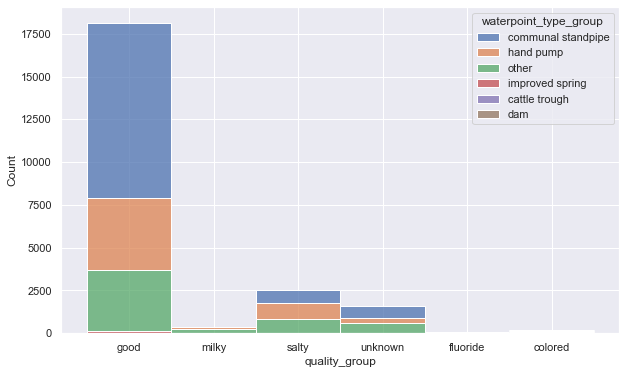

In [59]:
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.histplot(data = df.loc[df['status_group']=='non functional'], x = 'quality_group', 
             hue = 'waterpoint_type_group', multiple = 'stack', kde = False)

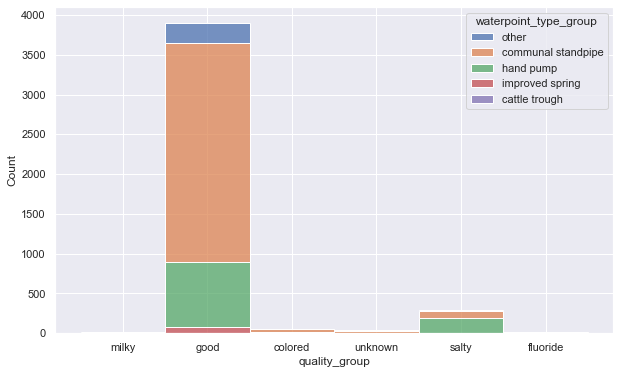

In [60]:
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.histplot(data = df.loc[df['status_group']=='functional needs repair'], x = 'quality_group', 
             hue = 'waterpoint_type_group', multiple = 'stack', kde = False)

Between functional and that needs repair, the 'salty water' seems to important issue to look at. We will keep the 'quality_group' feature for now.

In [34]:
df.waterpoint_type_group.value_counts()

communal standpipe    34625
hand pump             17488
other                  6380
improved spring         784
cattle trough           116
dam                       7
Name: waterpoint_type_group, dtype: int64

In [35]:
df.waterpoint_type.value_counts()

communal standpipe             28522
hand pump                      17488
other                           6380
communal standpipe multiple     6103
improved spring                  784
cattle trough                    116
dam                                7
Name: waterpoint_type, dtype: int64

We will use 'waterpoint_type_group' as it is more consolidated.

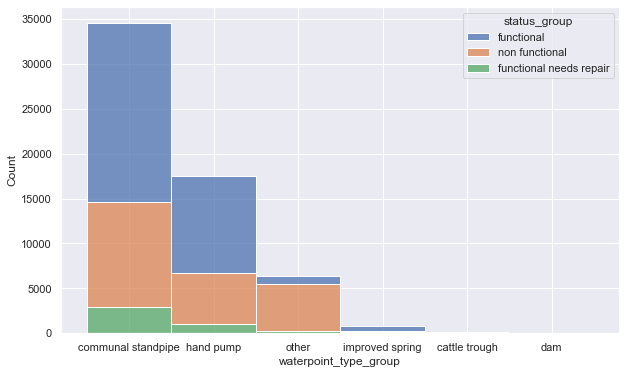

In [36]:
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.histplot(data = df, x = 'waterpoint_type_group', 
             hue = 'status_group', multiple = 'stack', kde = False)

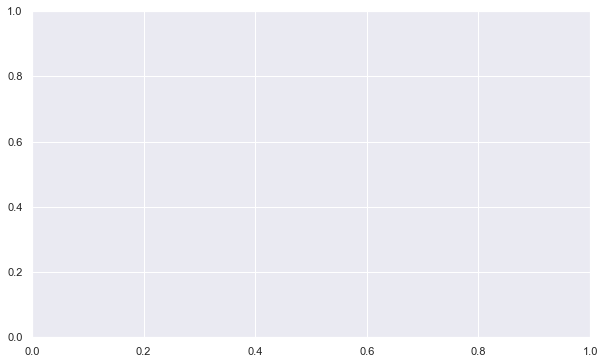

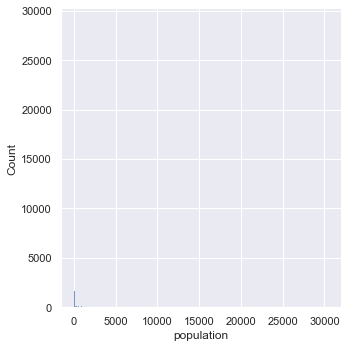

In [63]:
fig, ax = plt.subplots(figsize=(10,6))
ax = sns.displot(data = df, x = 'population', 
             hue = None)

In [37]:
df.source.value_counts()

spring                  17021
shallow well            16824
machine dbh             11075
river                    9612
rainwater harvesting     2295
hand dtw                  874
lake                      765
dam                       656
other                     212
unknown                    66
Name: source, dtype: int64

In [38]:
df.source_type.value_counts()

spring                  17021
shallow well            16824
borehole                11949
river/lake              10377
rainwater harvesting     2295
dam                       656
other                     278
Name: source_type, dtype: int64

In [39]:
df.source_class.value_counts()

groundwater    45794
surface        13328
unknown          278
Name: source_class, dtype: int64

Between 'source', 'source_type' and 'source_class', the 'source_type' seems to be more useful. But will test -type and -class.

In [40]:
cols_large_categ =  ['lga', 'date_recorded', 'funder', 'ward', 'installer', 
                     'scheme_name', 'subvillage', 'wpt_name'] 

numeric_cols_to_drop = ['num_private', 'region_code', 'district_code', 'latitude',
                       'longitude', 'id']

redundant_cols = ['quantity', 'water_quality', 'management', 'scheme_management', 'waterpoint_type', 
                     'source', 'source_type']

In [41]:
train.columns

Index(['id', 'amount_tsh', 'date_recorded', 'funder', 'gps_height',
       'installer', 'longitude', 'latitude', 'wpt_name', 'num_private',
       'basin', 'subvillage', 'region', 'region_code', 'district_code', 'lga',
       'ward', 'population', 'public_meeting', 'recorded_by',
       'scheme_management', 'scheme_name', 'permit', 'construction_year',
       'extraction_type', 'extraction_type_group', 'extraction_type_class',
       'management', 'management_group', 'payment', 'payment_type',
       'water_quality', 'quality_group', 'quantity', 'quantity_group',
       'source', 'source_type', 'source_class', 'waterpoint_type',
       'waterpoint_type_group'],
      dtype='object')

In [42]:
df = pd.merge(train, target, on = 'id')

In [24]:
df.status_group

0            functional
1            functional
2            functional
3        non functional
4            functional
              ...      
59395        functional
59396        functional
59397        functional
59398        functional
59399        functional
Name: status_group, Length: 59400, dtype: object

In [30]:
label_encoder = {'functional': 'functional',
                 'non functional': 'non functional',
                 'functional needs repair': 'non functional'}
df['status_group'] = df['status_group'].map(label_encoder)

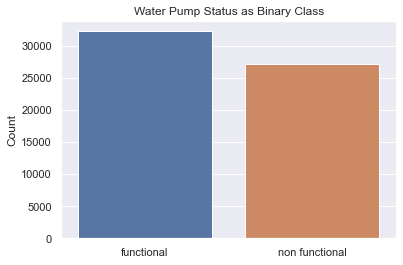

In [32]:
sns.countplot(data=df, x= 'status_group')
plt.title('Water Pump Status as Binary Class')
plt.xlabel('')
plt.ylabel('Count')
plt.savefig('images/water_pump_status_count_binary.png')

In [21]:
def location_map(df, color, title):
    fig = px.scatter_mapbox(df, lat="latitude", lon="longitude",
                           #size = None,
                            color = color,
                            size_max = 5,
                            zoom = 5,
                            height = 600,
                            title = title,
                            hover_data = {'region':True,
                                         'construction_year':True,
                                         }
                           )
    fig.update_layout(mapbox_style ="carto-positron")
    fig.show()

In [22]:
location_map(df.loc[df['population']<1000], 'population', title ='Population distribution')

In [23]:
location_map(df, 'status_group', title='Water Pump Status in Tanzania' )
plt.savefig('images/water_pump_status_by_construction_year.png', bbox_inces='tight')

In [17]:
location_map(test, 'region')

<AxesSubplot:xlabel='population', ylabel='Count'>

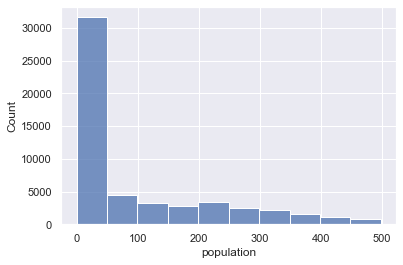

In [20]:
sns.histplot(data=df.loc[df['population']<500], x='population', bins =10)

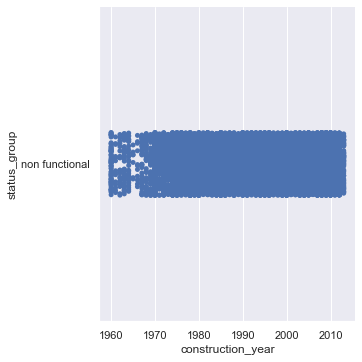

In [47]:
sns.catplot(data=df.loc[(df['construction_year']>0) & (df['status_group']=='non functional')], 
            x = 'construction_year', y = 'status_group',
            )

<AxesSubplot:>

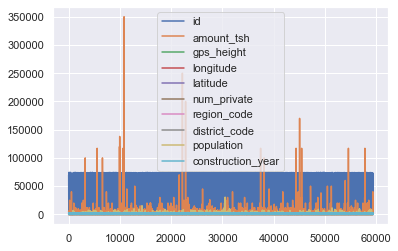

In [48]:
# g = sns.FacetGrid(data=df, row='population', col='status_group', margin_titles=True)
# g.map(sns.regplot, 'construction_year')
df.plot()

In [44]:
df_plot = df.groupby(['region'])['population'].sum().sort_values(ascending=False)
# df_plot
top_regions = set(df_plot.index[:5])
t = ['tab:blue' if x in top_regions else 'grey' for x in df_plot.index]
t
# df.plot(kind='bar', figsize=(12,8), color=['blue', 'grey'])

['tab:blue',
 'tab:blue',
 'tab:blue',
 'tab:blue',
 'tab:blue',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey',
 'grey']

<AxesSubplot:xlabel='region'>

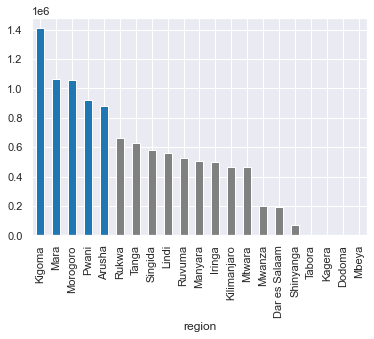

In [45]:
df_plot.plot(kind='bar', color = t)

In [49]:
df_plot2 = df.loc[df['status_group']=='non functional'].groupby(['region'])['status_group'].count().sort_values(ascending=False)
df_plot2

region
Mbeya            2320
Shinyanga        2193
Morogoro         1887
Kilimanjaro      1739
Mwanza           1600
Kagera           1589
Kigoma           1453
Mtwara           1206
Dodoma           1192
Ruvuma           1160
Iringa           1153
Tanga            1111
Tabora           1111
Rukwa            1101
Lindi            1086
Mara             1083
Singida          1082
Pwani            1079
Arusha           1056
Manyara           596
Dar es Salaam     344
Name: status_group, dtype: int64

In [50]:
c = ['tab:blue' if x in top_regions else 'grey' for x in df_plot2.index]

<AxesSubplot:xlabel='region'>

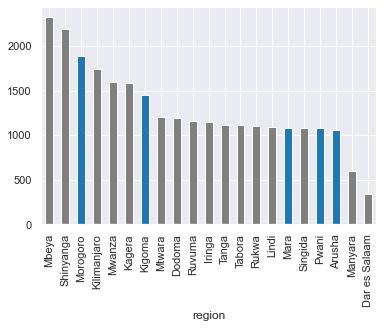

In [52]:
df_plot2.plot(kind='bar', color = c)

<AxesSubplot:xlabel='waterpoint_type'>

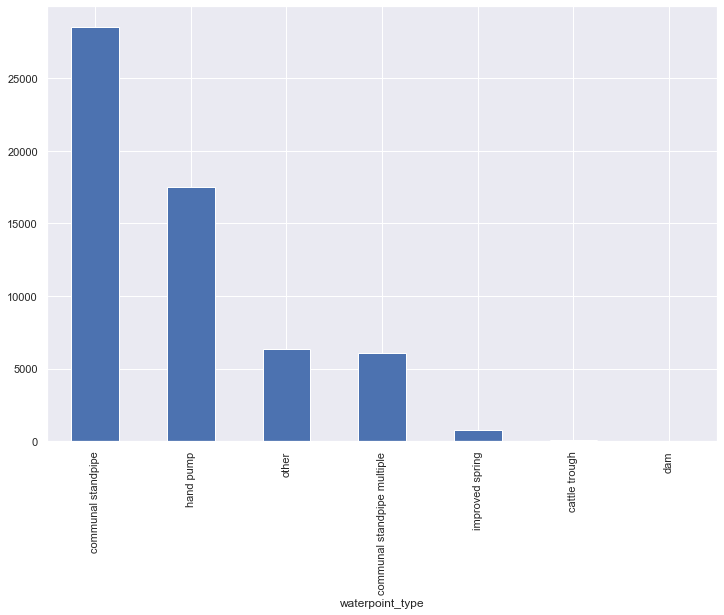

In [50]:
df.groupby('waterpoint_type')['status_group'].count().sort_values(ascending=False).plot(kind='bar', figsize=(12,8))
# plt.xlabel('WaterPoint_type', fontsize=15)
# plt.ylabel('Count)', fontsize=15)
# plt.xticks(rotation='vertical', fontsize=12)
# plt.title('Movies with high production cost', fontsize=20);

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20]),
 [Text(0, 0, 'Iringa'),
  Text(1, 0, 'Mara'),
  Text(2, 0, 'Manyara'),
  Text(3, 0, 'Mtwara'),
  Text(4, 0, 'Kagera'),
  Text(5, 0, 'Tanga'),
  Text(6, 0, 'Shinyanga'),
  Text(7, 0, 'Tabora'),
  Text(8, 0, 'Pwani'),
  Text(9, 0, 'Ruvuma'),
  Text(10, 0, 'Kilimanjaro'),
  Text(11, 0, 'Rukwa'),
  Text(12, 0, 'Mwanza'),
  Text(13, 0, 'Kigoma'),
  Text(14, 0, 'Lindi'),
  Text(15, 0, 'Dodoma'),
  Text(16, 0, 'Arusha'),
  Text(17, 0, 'Mbeya'),
  Text(18, 0, 'Singida'),
  Text(19, 0, 'Morogoro'),
  Text(20, 0, 'Dar es Salaam')])

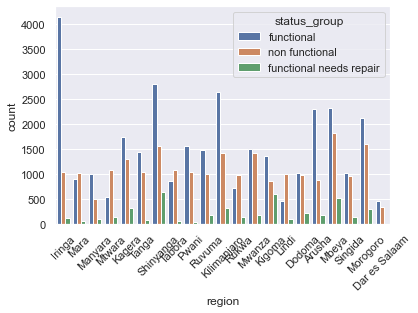

In [108]:
sns.countplot(data=df.loc[:, ['region', 'status_group']], x='region', hue='status_group')
plt.xticks(rotation=45)


<AxesSubplot:xlabel='region'>

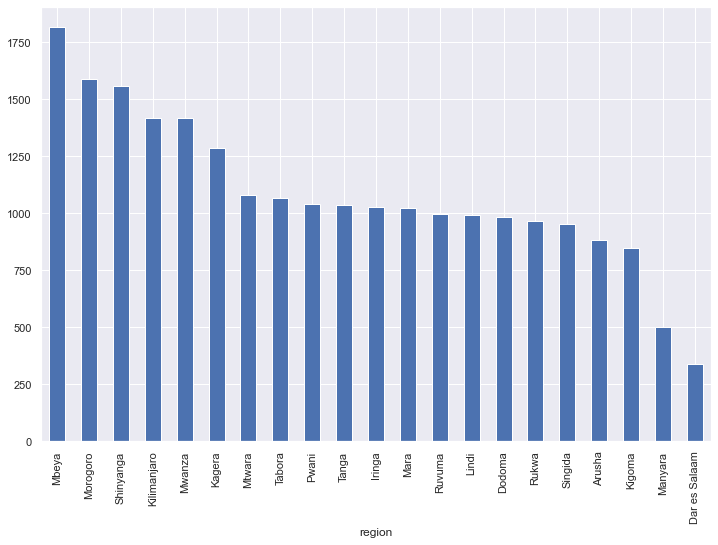

In [100]:
df.loc[(df['status_group']=='non functional')].groupby('region')['status_group'].count().sort_values(ascending=False).plot(kind='bar', figsize=(12,8))
# plt.xlabel('WaterPoint_type', fontsize=15)
# plt.ylabel('Count)', fontsize=15)
# plt.xticks(rotation='vertical', fontsize=12)
# plt.title('Movies with high production cost', fontsize=20);

<AxesSubplot:xlabel='region'>

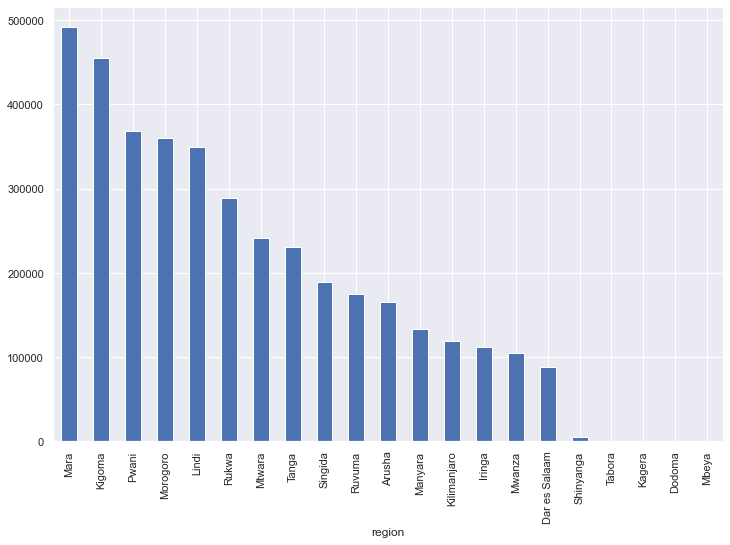

In [110]:
df.loc[(df['status_group']=='non functional')].groupby('region')['population'].sum().sort_values(ascending=False).plot(kind='bar', figsize=(12,8))
